In [302]:
import math
# import random

import gym
import numpy

import jax
import time
# from numpy import random

from jax import grad, value_and_grad
import jax.numpy as np
from jax import random, jit, jacfwd
from jax.ops import index, index_add, index_update

from collections import namedtuple


In [2]:
import matplotlib.pyplot as plt

from matplotlib import animation, rc
from IPython.display import HTML
%matplotlib inline

In [3]:
numpy.arange(10,0,-1)

array([10,  9,  8,  7,  6,  5,  4,  3,  2,  1])

In [5]:
# params = {
#     g: 10,
#     m: 1,
#     l: 1,
#     dt: 0.05,
#     max_torque: 2,
#     max_speed: 8
# }
ParamTuple = namedtuple('Params', [
    "g",
    "m",
    "l",
    "dt",
    "max_torque",
    "max_speed"
])

params = ParamTuple(10, 1, 1, 0.05, 2, 8)

T = 200

@jit
def angle_normalize(x):
    return ((x+np.pi) % (2*np.pi)) - np.pi

# @jit
# def controlledPendulumStep(th, thdot, u):
#     u = np.clip(u, -max_torque, max_torque)
#     cost = angle_normalize(th) ** 2 + .1 * thdot ** 2 + .001 * (u ** 2)
#     newthdot = thdot + (-3 * g / (2 * l) * np.sin(th + np.pi) + 3. / (m * l ** 2) * u) * dt
#     newth = th + newthdot * dt
#     newthdot = np.clip(newthdot, -max_speed, max_speed)

#     return np.array((newth, newthdot, cost))

# @jit
# def pendulumTraj(th0, thdot0, uVect):
#     th, thdot = th0, thdot0
#     traj = np.zeros((3,len(uVect)))
#     for t in range(len(uVect)):
#         state = controlledPendulumStep(th, thdot, uVect[t])
#         traj = index_update(traj, index[:, t], state)
#         th = state[0]
#         thdot = state[1]
#     return traj

# # @jit
# def pendulumTraj2(th0, thdot0, uVect):
#     th, thdot = th0, thdot0
#     traj = np.zeros((3,len(uVect)))
#     for t in range(len(uVect)):
#         # state = controlledPendulumStep(th, thdot, uVect[t])

#         u = np.clip(uVect[t], -max_torque, max_torque)
#         cost = angle_normalize(th) ** 2 + .1 * thdot ** 2 + .001 * (u ** 2)
#         thdot = thdot + (-3 * g / (2 * l) * np.sin(th + np.pi) + 3. / (m * l ** 2) * u) * dt
#         thdot = np.clip(thdot, -max_speed, max_speed)
#         th = th + thdot * dt

#         traj = index_update(traj, index[:, t], np.array((th, thdot, cost)))
#         # th = state[0]
#         # thdot = state[1]
#     return traj

# # @jit
# def pendulumTrajCost(th0, thdot0, uVect):
#     traj = pendulumTraj(th0, thdot0, uVect)
#     cost = sum(traj[2,:])
#     return cost


# th0, thdot0 = 2,0

# f = lambda control: pendulumTrajCost(th0, thdot0, control)

# trajectoryGrad = grad(f)


In [145]:
@jit
def controlledPendulumStep_scan(state, u):
    th, thdot, params = state

    u = np.clip(u, -params.max_torque, params.max_torque)
    
    thdot = np.clip(
        thdot + (-3.0 * params.g / (2 * params.l) * np.sin(th + np.pi) + 3.0 / (params.m * params.l ** 2) * u) * params.dt,
        -params.max_speed,
        params.max_speed
    )
    th = th + thdot * params.dt

    cost = angle_normalize(th) ** 2 + .1 * thdot ** 2 + .001 * (u ** 2)
    # newthdot = newthdot, -max_speed, max_speed)

    return (th, thdot, params), np.array((th, thdot, cost))

@jit
def pendulumTraj_scan(th0, thdot0, uVect, params):
    state = (th0, thdot0, params)
    _, traj = jax.lax.scan(controlledPendulumStep_scan, state, uVect)
    return traj

@jit
def costOfTrajectory(traj):
    return np.sum(traj[:,2])

@jit
def pendulumTrajCost_scan(th0, thdot0, uVect, params):
    traj = pendulumTraj_scan(th0, thdot0, uVect, params)   
    return costOfTrajectory(traj)


trajectoryGrad_scan = jax.jit(grad(pendulumTrajCost_scan, argnums=2))
trajectoryValAndGrad_scan = jax.jit(value_and_grad(pendulumTrajCost_scan, argnums=2))



In [261]:
# pendulumTraj_scan(-1.5,1.0,np.zeros(5),params)

DeviceArray([[-1.487406  ,  0.25187874,  2.218721  ],
             [-1.5121818 , -0.49551505,  2.311247  ],
             [-1.5743932 , -1.244227  ,  2.633524  ],
             [-1.6741042 , -1.9942222 ,  3.2003171 ],
             [-1.8111154 , -2.7402234 ,  4.0310216 ]], dtype=float32)

In [80]:
@jit
def controlledPendulumStep_derivs(th, thdot, params):
    d_thdot = (-3 * params.g / (2 * params.l) * np.sin(th + np.pi) + 3. / (params.m * params.l ** 2) * 0) * params.dt
    newthdot = thdot + d_thdot
    d_th = newthdot * params.dt

    return np.array((d_th, d_thdot))


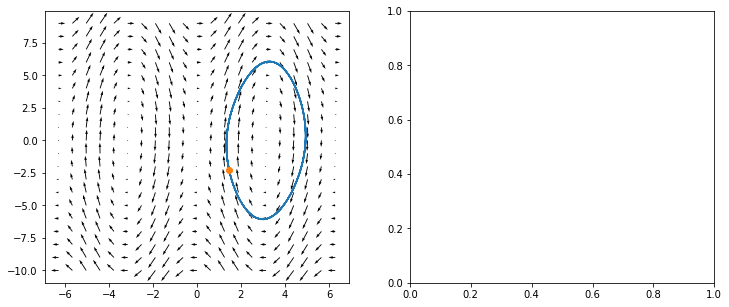

In [160]:
traj = pendulumTraj_scan(np.pi/2,-3.0, np.zeros(200), params)

def plotTrajInPhaseSpace(traj, params, uVect=None):
    X = np.linspace(-2*np.pi, 2*np.pi, 21)
    Y = np.arange(-params.max_speed-2, params.max_speed+2, 1)

    U, V = np.meshgrid(X, Y)
    gridshape = U.shape

    THDOT, THDOTDOT = controlledPendulumStep_derivs(
        U.ravel(),
        V.ravel(),
        params
    )

    THDOT = THDOT.reshape(gridshape)
    THDOTDOT = THDOTDOT.reshape(gridshape)

    fig, (axPhase, axU) = plt.subplots(1,2,figsize=(12,5))
    q = axPhase.quiver(X, Y, THDOT, THDOTDOT)
    axPhase.plot(traj[:,0], traj[:,1])
    axPhase.plot(traj[0,0], traj[0,1], "o")

    if uVect is not None:
        axU.plot(uVect)

    plt.show()

plotTrajInPhaseSpace(traj,params)



In [161]:
uVect = -np.ones(100)*1.0
# numpy.random.randn(100)
%timeit pendulumTraj_scan(2.0,2.0,uVect,params)

uVect = -np.ones(1000)*1.0
# numpy.random.randn(100)
%timeit pendulumTraj_scan(2.0,2.0,uVect,params)

2.1 ms ± 104 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)
15.7 ms ± 525 µs per loop (mean ± std. dev. of 7 runs, 1 loop each)


# trajectory opt with grads

iter: 99; trajectory cost:1169.73779296875


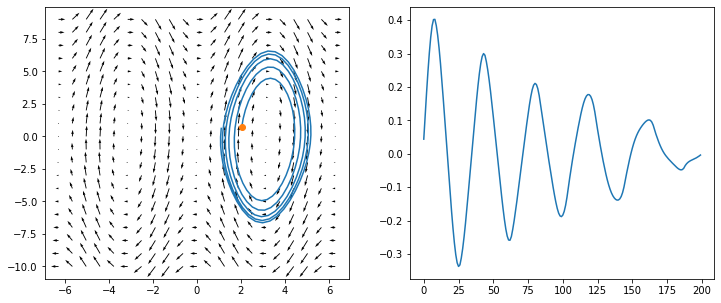

iter: 199; trajectory cost:1167.7490234375


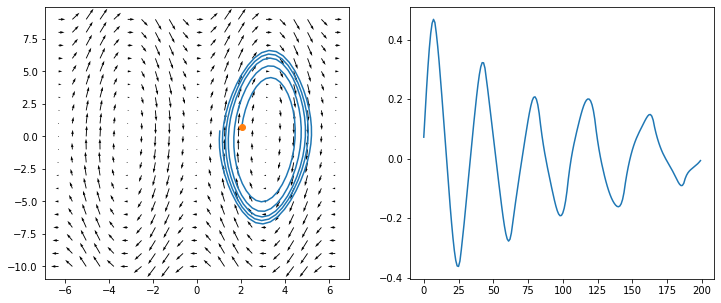

iter: 299; trajectory cost:1166.388427734375


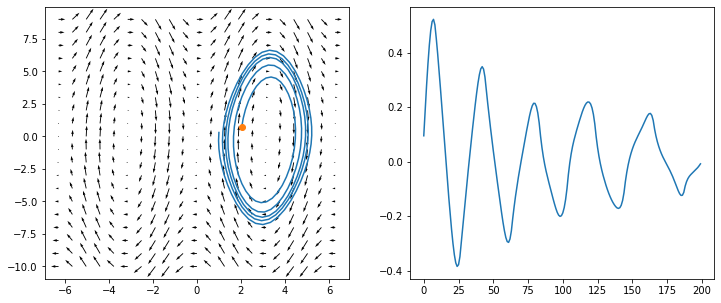

iter: 399; trajectory cost:1165.083984375


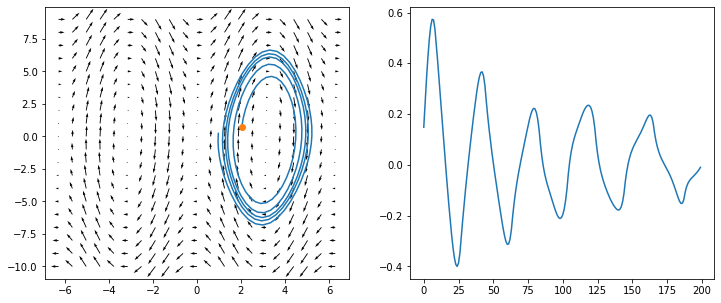

iter: 499; trajectory cost:1164.03564453125


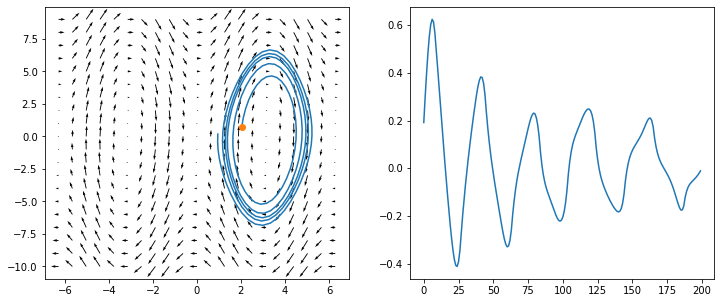

iter: 599; trajectory cost:1163.171875


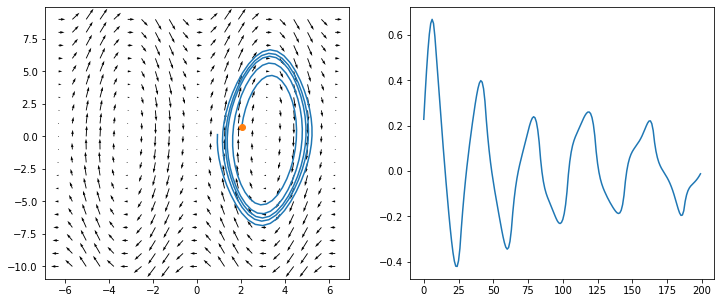

iter: 699; trajectory cost:1162.4486083984375


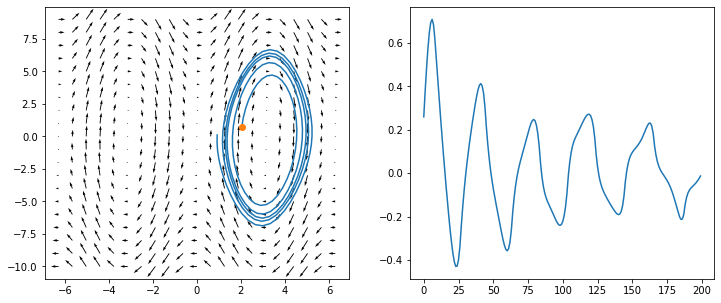

iter: 799; trajectory cost:1161.835693359375


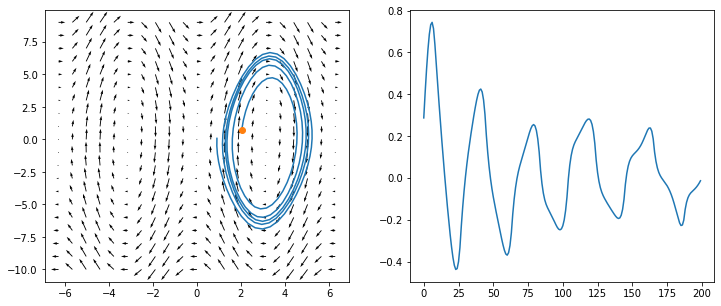

iter: 899; trajectory cost:1161.3121337890625


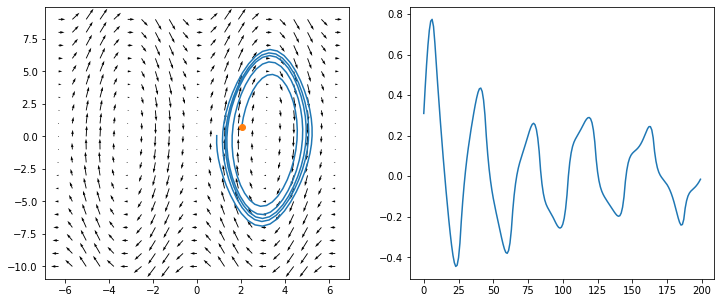

iter: 999; trajectory cost:1160.861328125


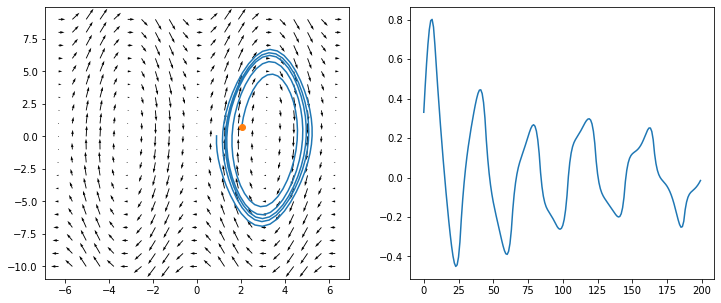

In [162]:
iters = 1000
LR = .001
th0, thdot0 = 2.0, 0.0
uVect = numpy.zeros(200)

savedTrajectories = []
savedInputs = []
for i in range(iters):
    # dgdu = trajectoryGrad_scan(th0, thdot0, uVect)
    dgdu = trajectoryGrad_scan(th0, thdot0, uVect, params)
        
    uVect = uVect - LR*(0.999**i) * dgdu #/np.linalg.norm(dgdu)

    if (i+1)%100==0:
        traj = pendulumTraj_scan(th0, thdot0, uVect, params)
        print(f"iter: {i}; trajectory cost:{costOfTrajectory(traj)}")
        plotTrajInPhaseSpace(traj, params, uVect)

In [139]:
def pendulum_traj_animation(traj,uVect,th0):
    fig, ax = plt.subplots()

    ax.set_xlim(( -2, 2))
    ax.set_ylim((-2, 2))
    ax.set_aspect(1)

    line, = ax.plot([], [], lw=2)
    line2, = ax.plot([], [], lw=2)

    saved_traj_num=2
    trajectory = traj[:,0]
    inputs = uVect
    # trajectory = savedTrajectories[saved_traj_num][0,:]
    # inputs = savedInputs[saved_traj_num]

    def init():
        line.set_data([0,np.sin(th0)], [0,np.cos(th0)])
        line2.set_data([0,0], [-1.5,-1.5])
        return (line,line2)

    def animate(i):
        tip_x = np.sin(trajectory[i])
        tip_y = np.cos(trajectory[i])

        line.set_data([0,tip_x], [0,tip_y])
        line2.set_data(
            [tip_x,tip_x + np.sin(trajectory[i]+np.pi/2)*inputs[i]],
            [tip_y,tip_y + np.cos(trajectory[i]+np.pi/2)*inputs[i]]
        )
        # line2.set_data([0, inputs[i]], [-1.5,-1.5])
        return (line,line2)

    anim = animation.FuncAnimation(fig, animate, init_func=init,
                                frames=len(trajectory), interval=1000*.05, 
                                blit=True)

    return HTML(anim.to_jshtml())


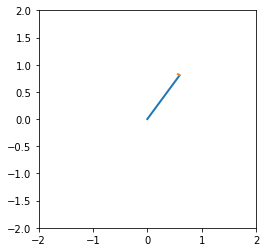

In [140]:
pendulum_traj_animation(traj, uVect, th0)

# fake MPC

iter: 0; total cost:480.89776611328125


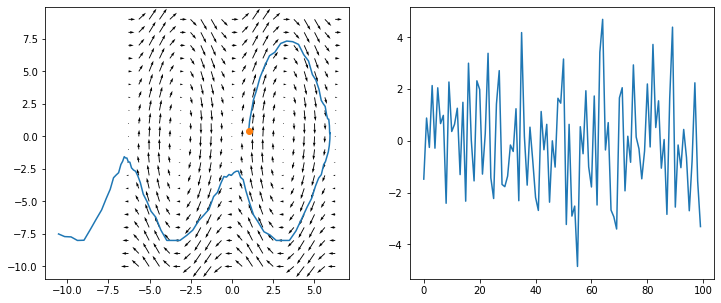

iter: 999; total cost:378.641357421875


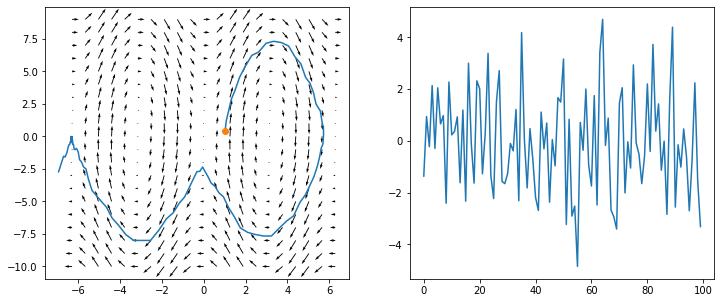

iter: 0; total cost:568.6649169921875


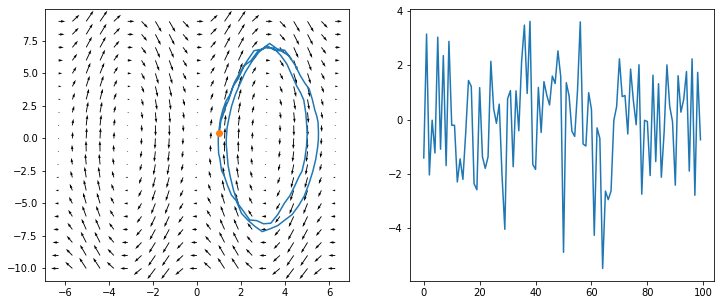

iter: 999; total cost:474.9029541015625


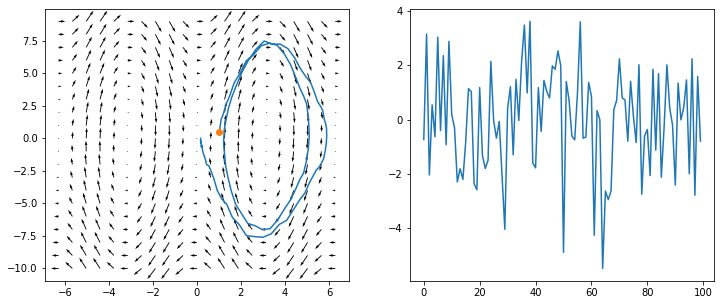

iter: 0; total cost:486.3643798828125


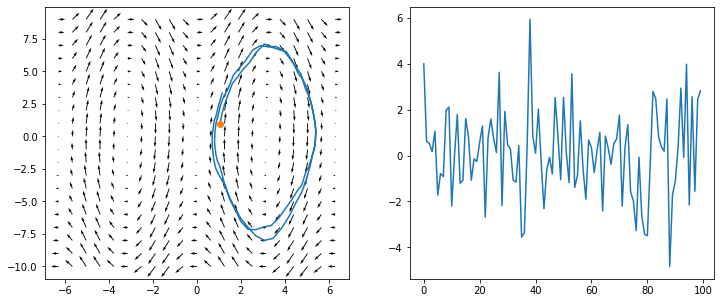

iter: 999; total cost:477.7034606933594


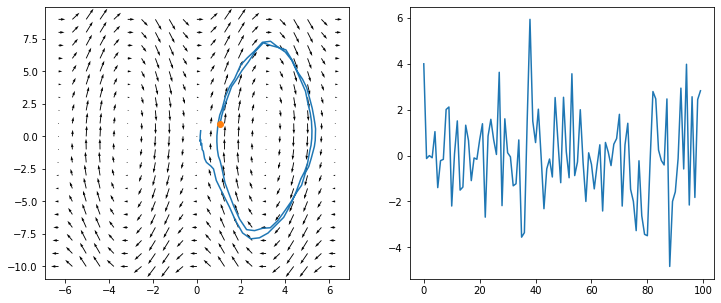

iter: 0; total cost:408.00384521484375


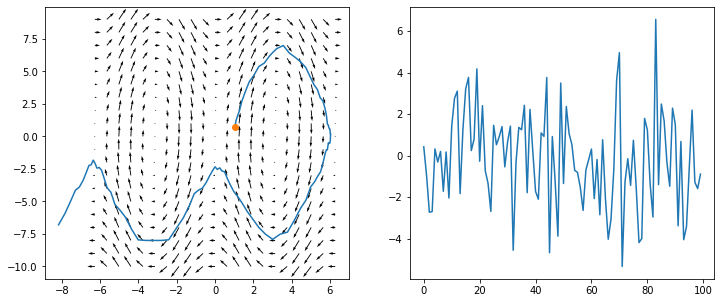

KeyboardInterrupt: 

In [165]:
# optimize random initial control vector
random_starts = 10
iters = 1000
LR = .1
th0, thdot0 = 1.0, 0.0

T = 100

for j in range(random_starts):
    uVect = 2*numpy.random.randn(T)
    traj = pendulumTraj_scan(th0, thdot0, uVect, params)
    print(f"iter: 0; total cost:{costOfTrajectory(traj)}")
    plotTrajInPhaseSpace(traj, params, uVect)
    for i in range(iters):
        dgdu = trajectoryGrad_scan(th0, thdot0, uVect, params)
        uVect = uVect - LR*(0.999**i) * dgdu/np.linalg.norm(dgdu)        
        traj = pendulumTraj_scan(th0, thdot0, uVect, params)
    print(f"iter: {i}; total cost:{costOfTrajectory(traj)}")
    plotTrajInPhaseSpace(traj, params, uVect)

In [97]:
# rkey = random.PRNGKey(0)

# @jit
# def OUNoiseSample(noise_vec, mu=0.0, sigma=0.5, theta=0.05, key=random.PRNGKey(0)):
#     # noise_vec = np.zeros((1,T))
#     x=0
#     for t in range(len(noise_vec)):
#         # traj = 
#         key, subkey = random.split(key)
#         eps = random.normal(subkey, shape=(1,))
#         x += theta*(mu-x) + sigma * eps[0]
#         # noise_vec[t] = x
#         noise_vec = index_update(noise_vec, index[t], x)
#     return noise_vec

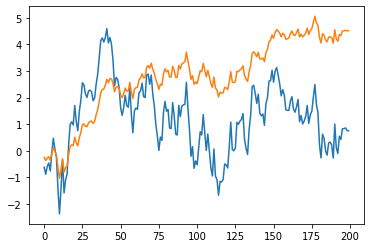

In [170]:

@jit
def OUNoiseStep(state, input):
    x, mu, sigma, theta, key = state
    key, subkey = random.split(key)
    x = x + theta * (mu - x) + sigma * random.normal(subkey)
    return (x, mu, sigma, theta, key), x

def OUNoiseSampleScan(T, mu=0.0, sigma=0.5, theta=0.05, key=random.PRNGKey(0)):
    state = (mu, mu, sigma, theta, key)
    _, noise = jax.lax.scan(OUNoiseStep, state, None, length=T)
    return noise

OUNoiseSampleScanJit = jit(OUNoiseSampleScan,static_argnums=(0,))

# plt.plot(2*numpy.random.randn(200))
plt.plot(OUNoiseSample(np.zeros(200)))
plt.plot(OUNoiseSampleScanJit(200, sigma=.2, theta=.001))

iter: 99; total cost:460.8172989189625


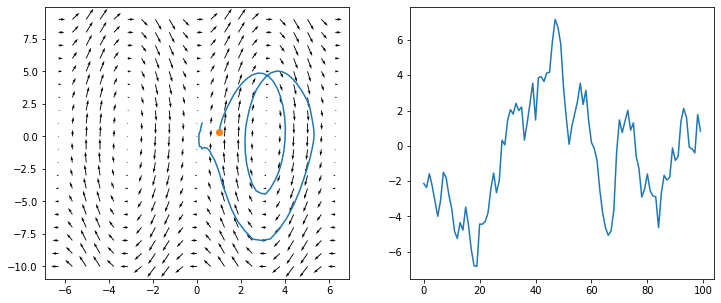

iter: 99; total cost:676.64286839962


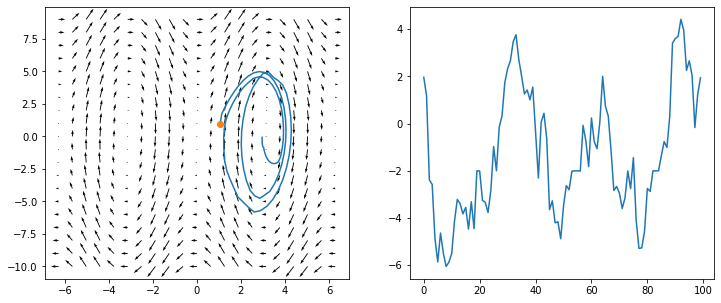

iter: 99; total cost:318.84472008794546


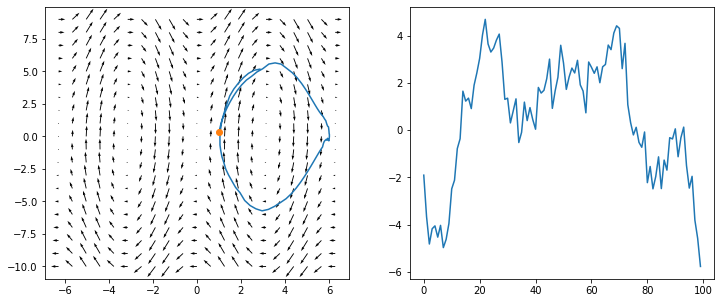

iter: 99; total cost:556.8839040994644


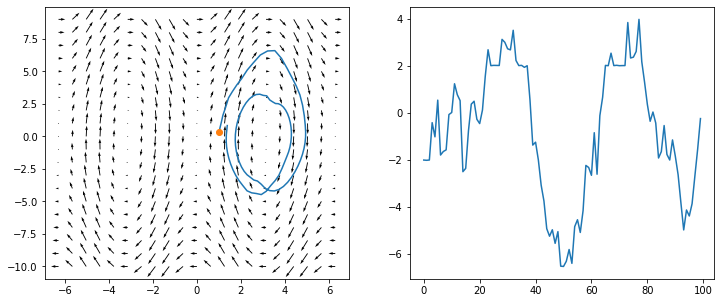

iter: 99; total cost:484.4715056940913


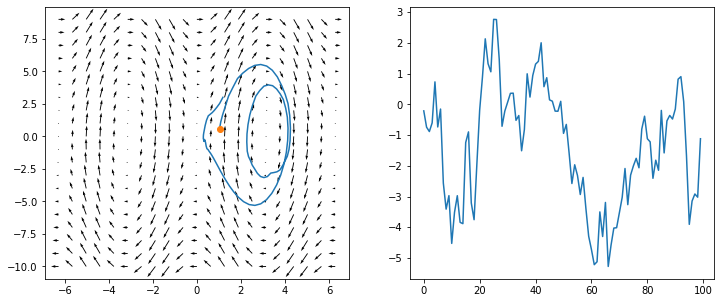

iter: 99; total cost:500.44117693789303


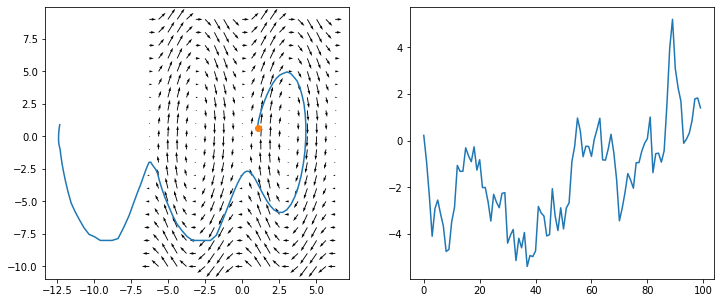

iter: 99; total cost:481.1859001889825


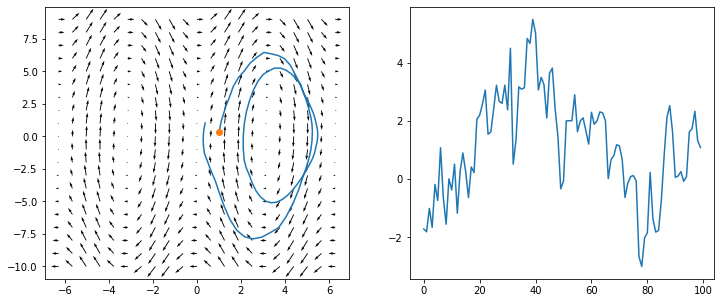

iter: 99; total cost:592.3245844244957


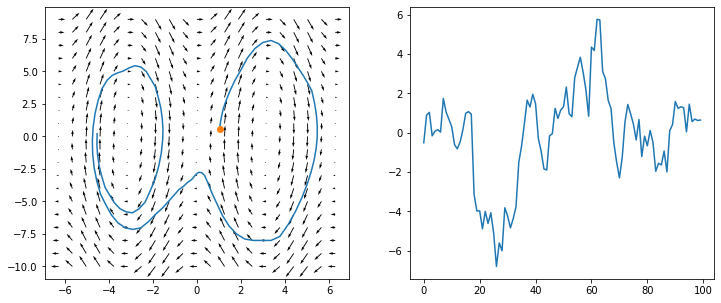

iter: 99; total cost:476.0228281915188


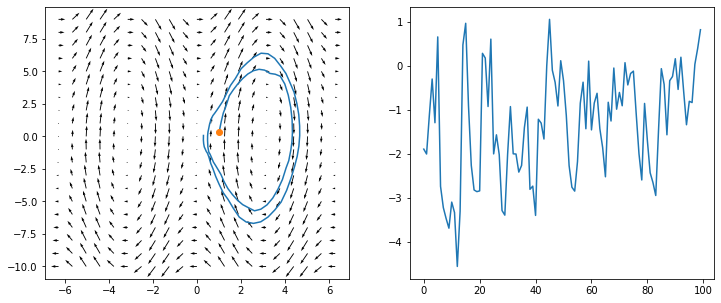

iter: 99; total cost:567.8897581994534


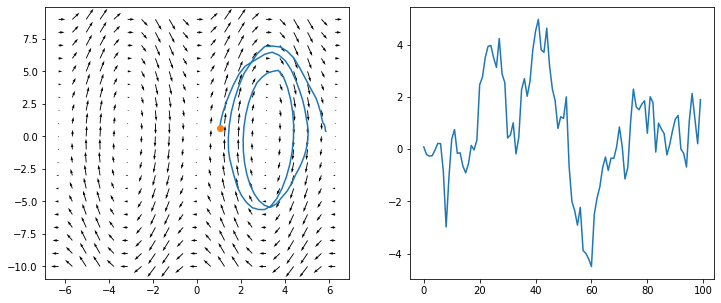

iter: 99; total cost:511.04884074628353


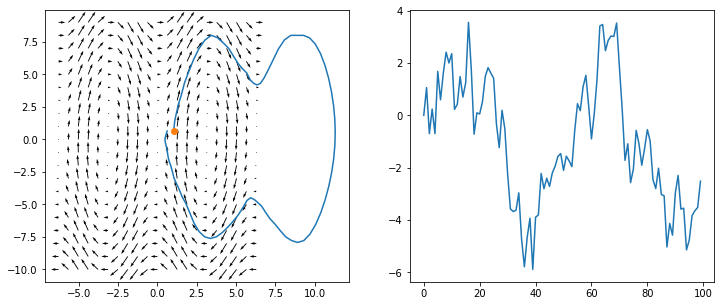

iter: 99; total cost:597.9872053917497


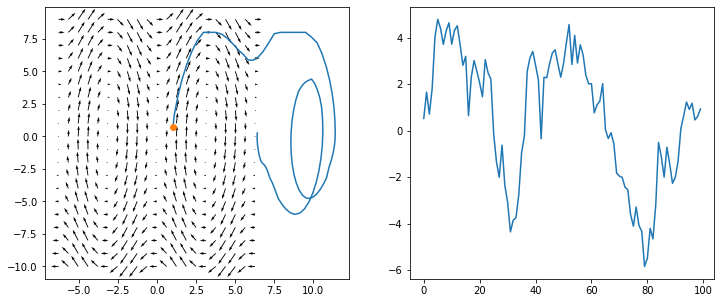

iter: 99; total cost:318.84472008794546


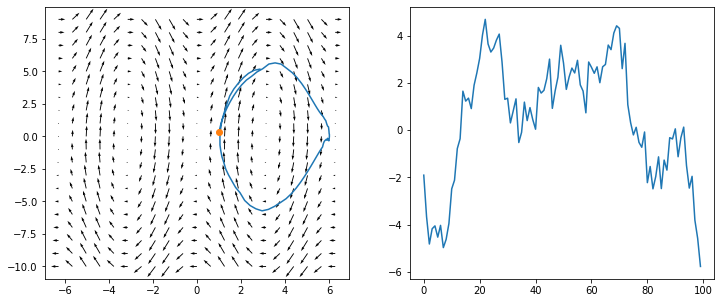

iter: 99; total cost:465.9574705930427


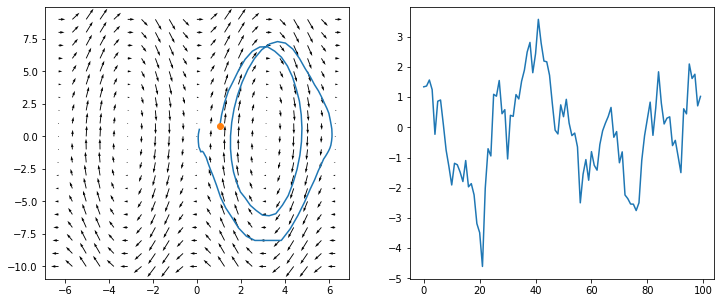

iter: 99; total cost:504.0312369391322


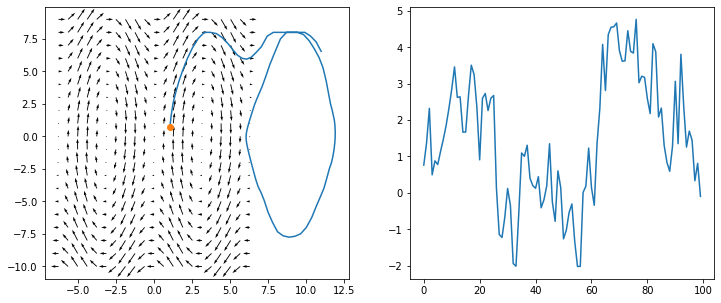

iter: 99; total cost:377.03700551611837


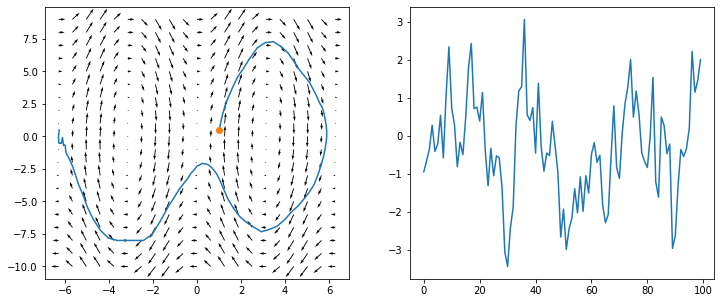

iter: 99; total cost:486.1474114358425


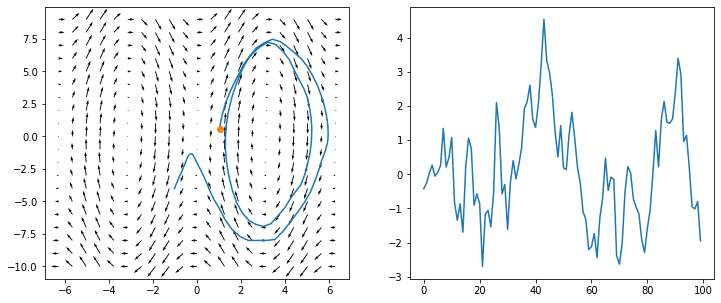

iter: 99; total cost:487.1743530128151


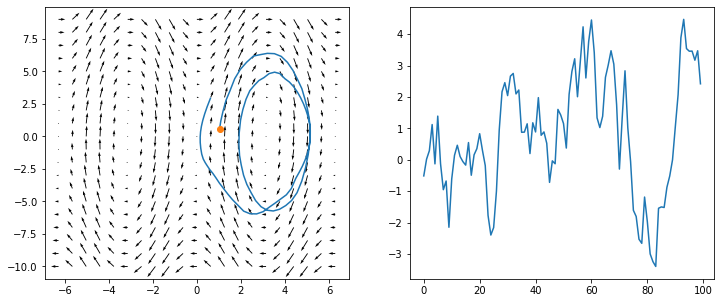

iter: 99; total cost:513.9646584959701


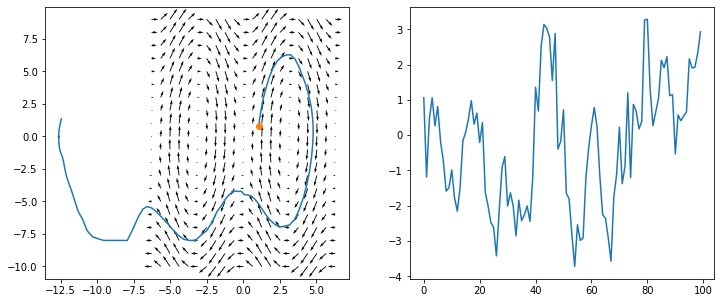

iter: 99; total cost:542.0285090929829


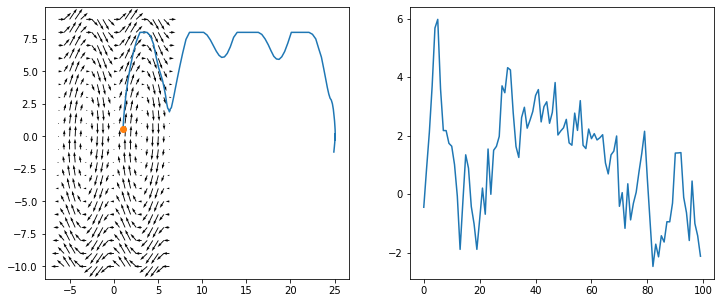

In [163]:
# optimize random initial control vector (OU noise)
# NOTE: OUNOISE seems to be worse than random normal

random_starts = 20
opt_iters = 100
LR = .1
th0, thdot0 = 1.0, 0.0

T = 100

for j in range(random_starts):
    key = random.PRNGKey(int(numpy.random.rand(1)*10000))
    uVect = OUNoiseSampleScanJit(T, sigma=1, theta=.1, key=key)

    for i in range(opt_iters):
        dgdu = trajectoryGrad_scan(th0, thdot0, uVect, params)
        uVect = uVect - LR*(0.99**i) * dgdu/np.linalg.norm(dgdu)        

        traj = pendulumTraj_scan(th0, thdot0, uVect, params)
    print(f"iter: {i}; total cost:{sum(traj[:,-1])}")
    plotTrajInPhaseSpace(traj, params, uVect)

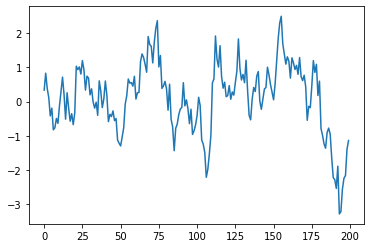

In [6]:
# def OUNoiseSample2(T, mu=0.0, sigma=0.5, theta=0.05):
#     noise_vec = numpy.zeros(T)
#     x=0
#     for t in range(T):
#         eps = numpy.random.randn()
#         x += theta*(mu-x) + sigma * eps
#         noise_vec[t] = x
#     return noise_vec

# plt.plot(OUNoiseSample2(200))

t: 0; best tragectory cost:740.7404174804688
t: 1; best tragectory cost:739.6920166015625
t: 2; best tragectory cost:738.4174194335938
t: 3; best tragectory cost:736.836669921875
t: 4; best tragectory cost:734.8790893554688
t: 5; best tragectory cost:732.2445068359375
t: 6; best tragectory cost:728.89697265625
t: 7; best tragectory cost:724.2067260742188
t: 8; best tragectory cost:718.3033447265625
t: 9; best tragectory cost:710.392822265625
t: 10; best tragectory cost:700.6502685546875
t: 11; best tragectory cost:688.2481079101562
t: 12; best tragectory cost:673.8186645507812
t: 13; best tragectory cost:661.7125244140625
t: 14; best tragectory cost:651.61865234375
t: 15; best tragectory cost:643.313720703125
t: 16; best tragectory cost:636.8759155273438
t: 17; best tragectory cost:632.2552490234375
t: 18; best tragectory cost:628.74267578125
t: 19; best tragectory cost:626.022216796875
t: 20; best tragectory cost:624.1953735351562
t: 21; best tragectory cost:622.90234375
t: 22; best t

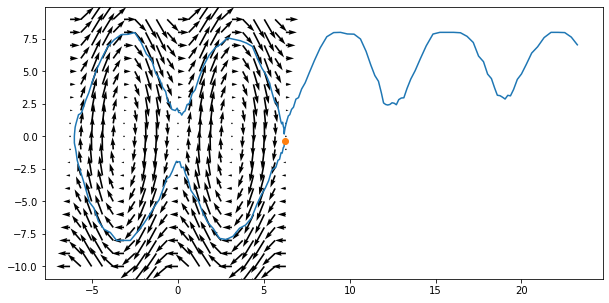

In [134]:
random_starts = 20
LR = .1
th, thdot = 1.0, 0.0

T = 200
finalInputs = numpy.zeros(T)

best_traj_cost = np.inf

for t in range(T-1):
    # always keep the best trajectory from the last iteration
    # available as an option (for iters after 0)
    if t != 0:
        best_traj = best_traj[1:,:]
        best_traj_cost = costOfTrajectory(best_traj)
        best_u = best_u[1:]

    for j in range(random_starts):
        uVect = 2*numpy.random.randn(T-t) 
        traj = pendulumTraj_scan(th, thdot, uVect, params)
        traj_cost = costOfTrajectory(traj)
        if traj_cost < best_traj_cost:
            best_traj_cost = traj_cost
            best_traj = traj
            best_u = uVect
    
    # since this is the trajectoy we're actually using
    # update the initial conditions of the next loop to use this
    th = best_traj[0,0]
    thdot = best_traj[0,1]
    finalInputs[t] = best_u[0].item()

    print(f"t: {t}; best tragectory cost:{best_traj_cost}")
    # plotTrajInPhaseSpace(best_traj, params)

final_traj = pendulumTraj_scan(th, thdot, finalInputs, params)
print(f"final trajectory cost: {costOfTrajectory(final_traj)}")
plotTrajInPhaseSpace(final_traj, params)

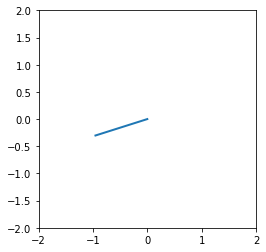

In [141]:
pendulum_traj_animation(final_traj, finalInputs, th)

In [142]:
# try optimizing each random candidate trajectory, maybe this will smooth out the noise that causes so much instability in the final trajectory above

random_starts = 20
opt_iters = 20

LR = .1
th, thdot = 1.0, 0.0

T = 200
finalInputs = numpy.zeros(T)

best_traj_cost = np.inf

for t in range(T-1):
    # always keep the best trajectory from the last iteration
    # available as an option (for iters after 0)
    if t != 0:
        best_traj = best_traj[1:,:]
        best_traj_cost = costOfTrajectory(best_traj)
        best_u = best_u[1:]

    for j in range(random_starts):
        uVect = 2*numpy.random.randn(T-t) 

        for i in range(opt_iters):
            dgdu = trajectoryGrad_scan(th0, thdot0, uVect, params)
            uVect = uVect - LR*(0.99**i) * dgdu/np.linalg.norm(dgdu)
    
        traj = pendulumTraj_scan(th, thdot, uVect, params)
        traj_cost = costOfTrajectory(traj)
        if traj_cost < best_traj_cost:
            best_traj_cost = traj_cost
            best_traj = traj
            best_u = uVect
    
    # since this is the trajectoy we're actually using
    # update the initial conditions of the next loop to use this
    th = best_traj[0,0]
    thdot = best_traj[0,1]
    finalInputs[t] = best_u[0].item()

    print(f"t: {t}; best tragectory cost:{best_traj_cost}")
    # plotTrajInPhaseSpace(best_traj, params)

final_traj = pendulumTraj_scan(th, thdot, finalInputs, params)
print(f"final trajectory cost: {costOfTrajectory(final_traj)}")
plotTrajInPhaseSpace(final_traj, params)

t: 0; best tragectory cost:759.761474609375
t: 1; best tragectory cost:758.6981201171875
t: 2; best tragectory cost:757.31982421875
t: 3; best tragectory cost:755.4718017578125
t: 4; best tragectory cost:746.3231201171875
t: 5; best tragectory cost:743.1282958984375
t: 6; best tragectory cost:738.7061767578125
t: 7; best tragectory cost:732.92529296875
t: 8; best tragectory cost:724.0037841796875
t: 9; best tragectory cost:714.401123046875
t: 10; best tragectory cost:702.3151245117188
t: 11; best tragectory cost:687.41845703125
t: 12; best tragectory cost:674.4591064453125
t: 13; best tragectory cost:663.9475708007812
t: 14; best tragectory cost:655.1776733398438
t: 15; best tragectory cost:648.4448852539062
t: 16; best tragectory cost:643.2163696289062
t: 17; best tragectory cost:639.3963623046875
t: 18; best tragectory cost:636.4602661132812
t: 19; best tragectory cost:632.8192138671875
t: 20; best tragectory cost:631.2822265625
t: 21; best tragectory cost:630.26513671875
t: 22; best

KeyboardInterrupt: 

t: 0; best tragectory cost:368.86981201171875
t: 1; best tragectory cost:364.3564453125
t: 2; best tragectory cost:323.18646240234375
t: 3; best tragectory cost:299.3352966308594
t: 4; best tragectory cost:296.2351379394531
t: 5; best tragectory cost:292.13262939453125
t: 6; best tragectory cost:276.833740234375
t: 7; best tragectory cost:247.21095275878906
t: 8; best tragectory cost:237.4350128173828
t: 9; best tragectory cost:225.55850219726562
t: 10; best tragectory cost:211.56883239746094
t: 11; best tragectory cost:198.6551055908203
t: 12; best tragectory cost:187.75621032714844
t: 13; best tragectory cost:178.772216796875
t: 14; best tragectory cost:171.62130737304688
t: 15; best tragectory cost:165.9277801513672
t: 16; best tragectory cost:146.71896362304688
t: 17; best tragectory cost:143.45062255859375
t: 18; best tragectory cost:141.19985961914062
t: 19; best tragectory cost:139.7779541015625
t: 20; best tragectory cost:129.296875
t: 21; best tragectory cost:128.6185913085937

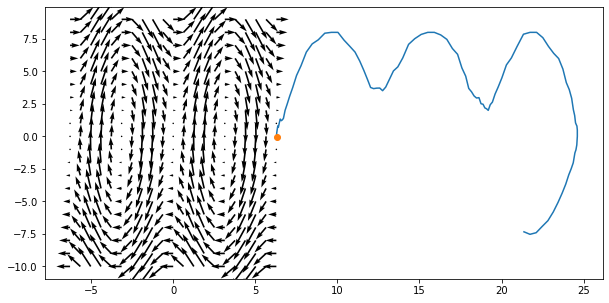

In [157]:
# optimizing ALL candidate trajectories, as above, is way too slow.
# maybe just optimize the *best* inputs

random_starts = 20
opt_iters = 20

LR = .1
th, thdot = 1.0, 0.0

T = 100
finalInputs = numpy.zeros(T)

best_traj_cost = np.inf

for t in range(T-1):
    # always keep the best trajectory from the last iteration
    # available as an option (for iters after 0)
    if t != 0:
        best_traj = best_traj[1:,:]
        best_traj_cost = costOfTrajectory(best_traj)
        best_u = best_u[1:]

    for j in range(random_starts):
        uVect = 2*numpy.random.randn(T-t) 
        traj = pendulumTraj_scan(th, thdot, uVect, params)
        traj_cost = costOfTrajectory(traj)
        if traj_cost < best_traj_cost:
            best_traj_cost = traj_cost
            best_traj = traj
            best_u = uVect.copy()

    uVect = best_u.copy()
    for i in range(opt_iters):
        dgdu = trajectoryGrad_scan(th, thdot, uVect, params)
        uVect = uVect - LR*(0.99**i) * dgdu/np.linalg.norm(dgdu)
        traj = pendulumTraj_scan(th, thdot, uVect, params)
        traj_cost = costOfTrajectory(traj)
        if traj_cost < best_traj_cost:
            best_traj_cost = traj_cost
            best_traj = traj
            best_u = uVect
    
    # since this is the trajectory we're actually using
    # update the initial conditions of the next loop to use this
    th = best_traj[0,0]
    thdot = best_traj[0,1]
    finalInputs[t] = best_u[0].item()

    print(f"t: {t}; best tragectory cost:{best_traj_cost}")
    # plotTrajInPhaseSpace(best_traj, params)

final_traj = pendulumTraj_scan(th, thdot, finalInputs, params)
print(f"final trajectory cost: {costOfTrajectory(final_traj)}")
plotTrajInPhaseSpace(final_traj, params)

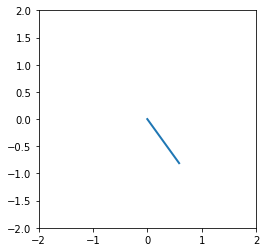

In [158]:
pendulum_traj_animation(final_traj, finalInputs, th)

# Damped spring noise

maybe noise modeled on a damped spring will be better, b/c it will be much much smoother even than OU noise

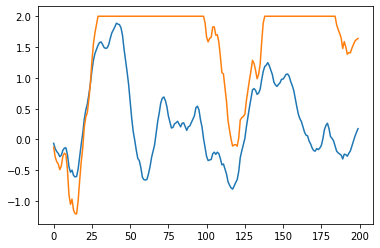

In [210]:
@jit
def dampedSpringNoiseStep(state, input):
    x, v, sigma, theta, phi, key = state
    key, subkey = random.split(key)
    v += -theta*x - phi*v + sigma*random.normal(subkey)
    x += v
    return (x, v, sigma, theta, phi, key), x

def dampedSpringNoiseScan(T, sigma=0.5, theta=0.05, phi=0.01, key=random.PRNGKey(0)):
    state = (0.0, 0.0, sigma, theta, phi, key)
    _, noise = jax.lax.scan(dampedSpringNoiseStep, state, None, length=T)
    return noise


dampedSpringNoiseJit = jit(dampedSpringNoiseScan,static_argnums=(0,))

# plt.plot(dampedSpringNoiseJit(200, sigma=.2, theta=.01,phi=.1))
plt.plot(dampedSpringNoiseJit(200, sigma=.05, theta=.02,phi=.1))
# plt.plot(dampedSpringNoiseJit(200, sigma=.2, theta=.01,phi=.01))
# plt.plot(dampedSpringNoiseJit(200, sigma=.2, theta=.1,phi=.01))
plt.plot(np.clip(
    dampedSpringNoiseJit(200, sigma=.1, theta=.005,phi=.2),
    -params.max_torque,
    params.max_torque)
)

before optimization: total cost:996.4941415432841


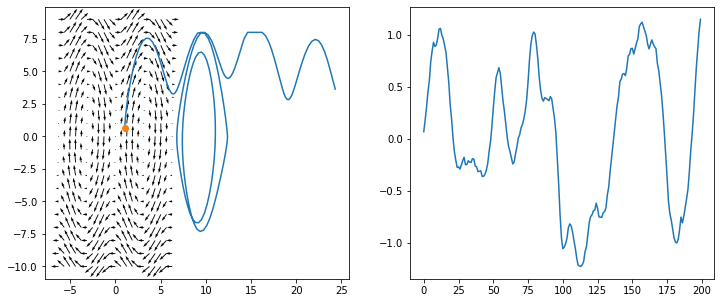

after 100 iters of optimization; total cost:972.3050775974989


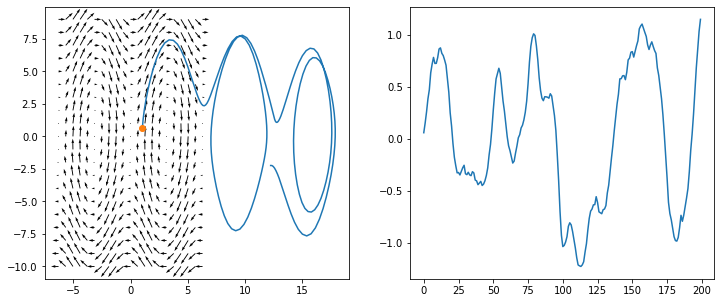

before optimization: total cost:1165.581242620945


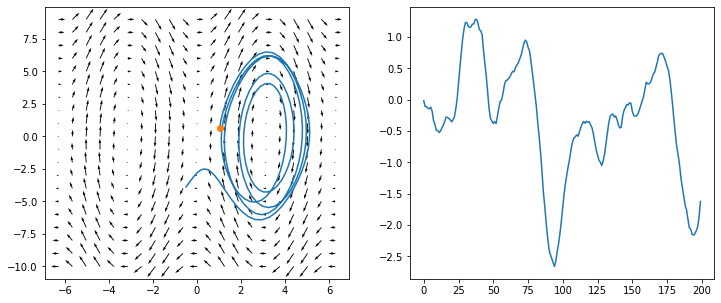

after 100 iters of optimization; total cost:1157.0297845304012


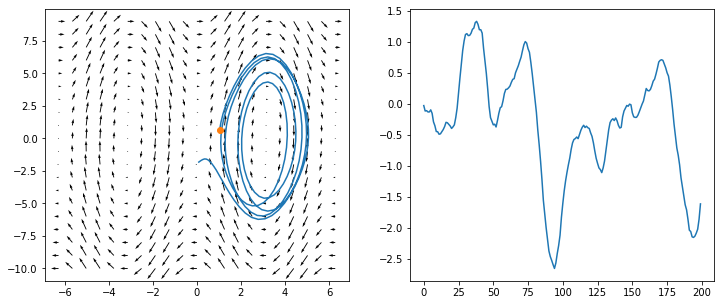

before optimization: total cost:1169.9548742771149


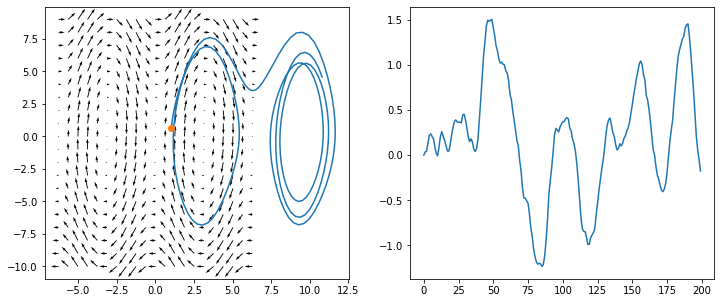

after 100 iters of optimization; total cost:895.25455750525


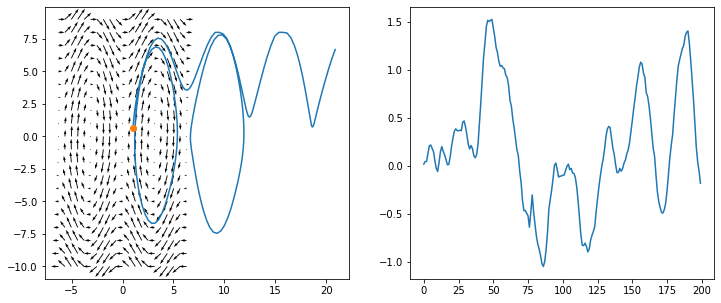

before optimization: total cost:1044.817757844925


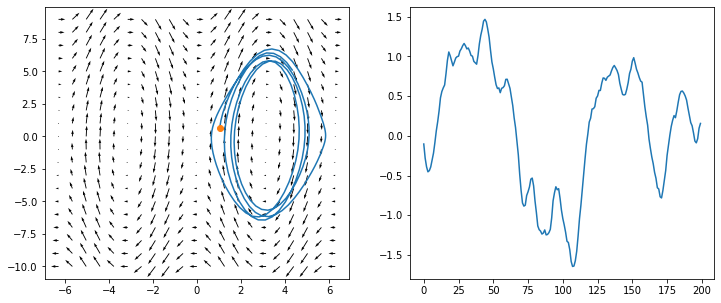

after 100 iters of optimization; total cost:932.4056207090616


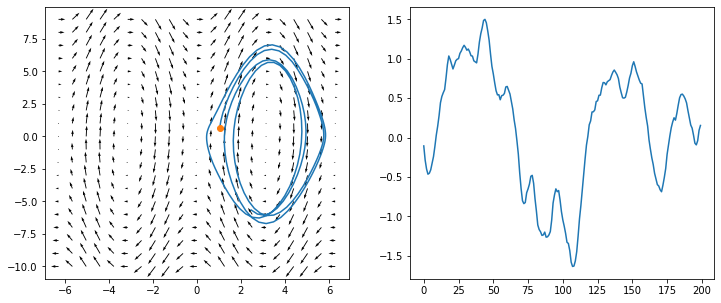

before optimization: total cost:1063.9145105555654


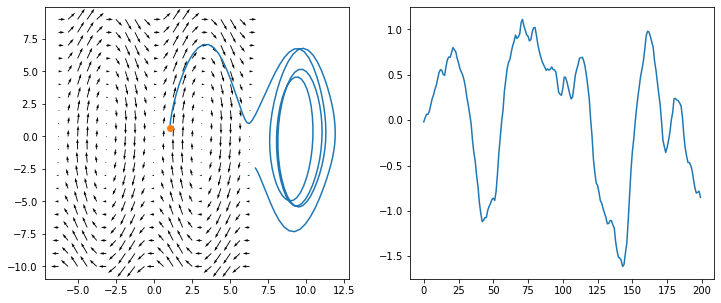

after 100 iters of optimization; total cost:1047.5124468654394


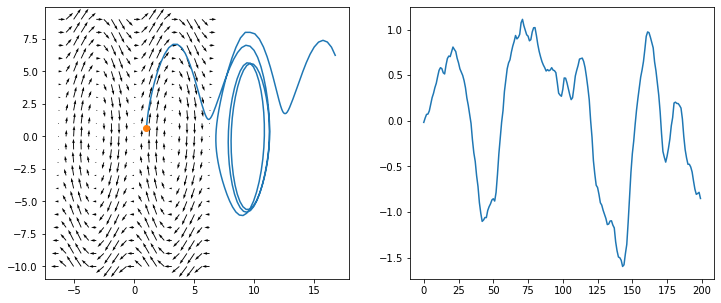

before optimization: total cost:1203.9919858276844


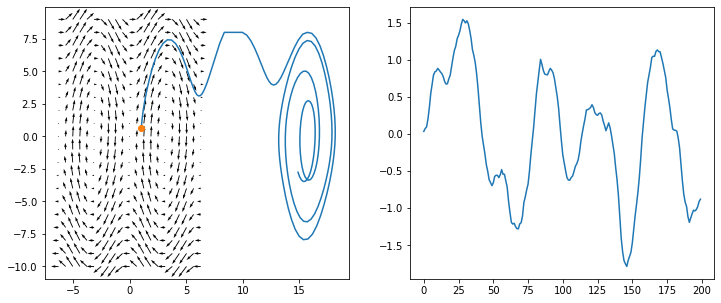

after 100 iters of optimization; total cost:1062.6527648414485


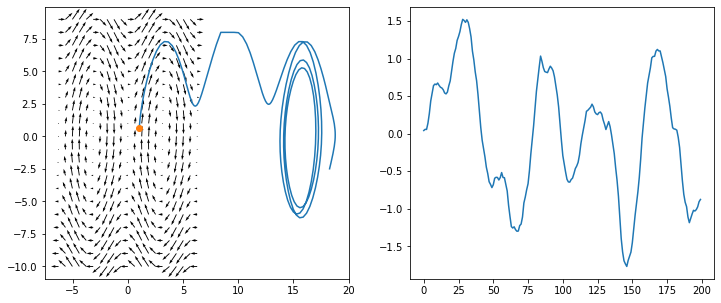

before optimization: total cost:1111.247224856168


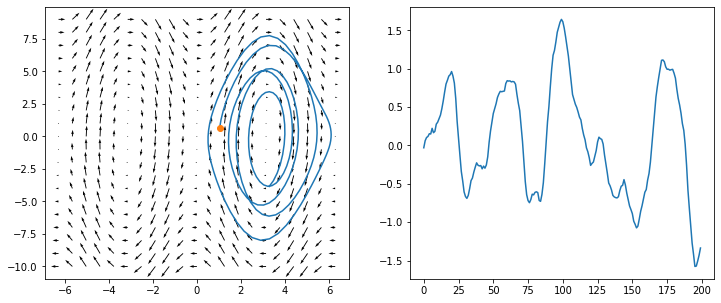

after 100 iters of optimization; total cost:950.3425197191536


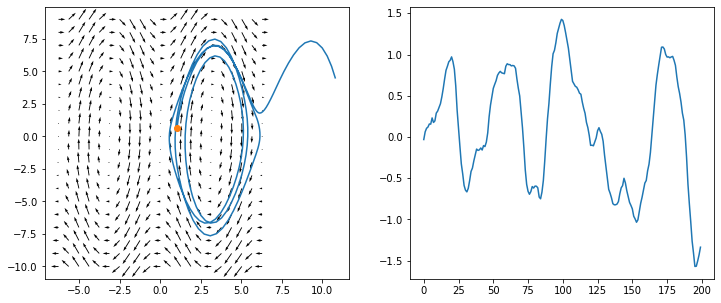

before optimization: total cost:1237.985909730196


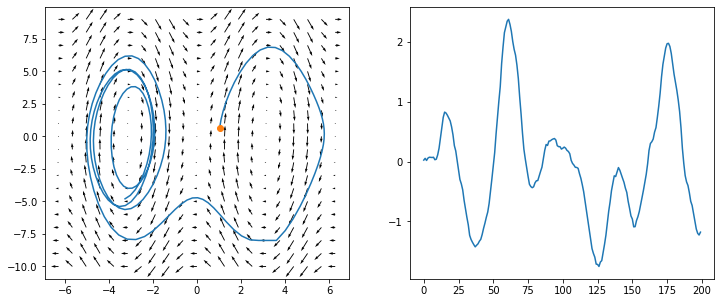

after 100 iters of optimization; total cost:1088.3079884946346


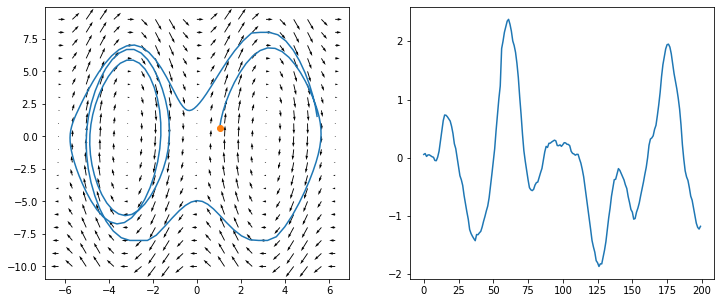

before optimization: total cost:981.090700276196


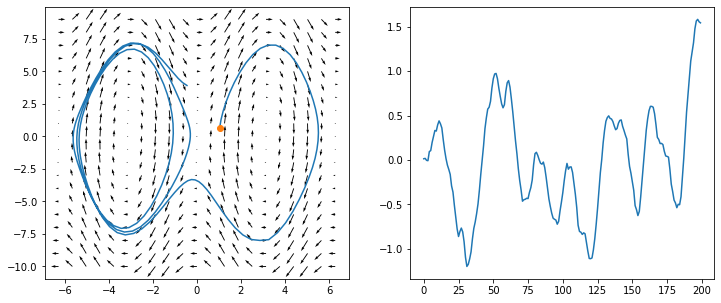

after 100 iters of optimization; total cost:969.2572445385158


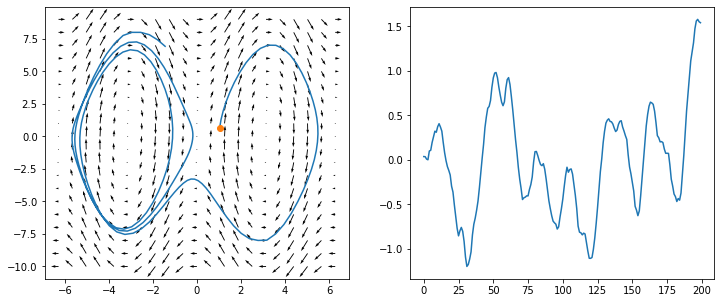

before optimization: total cost:1012.8844944685698


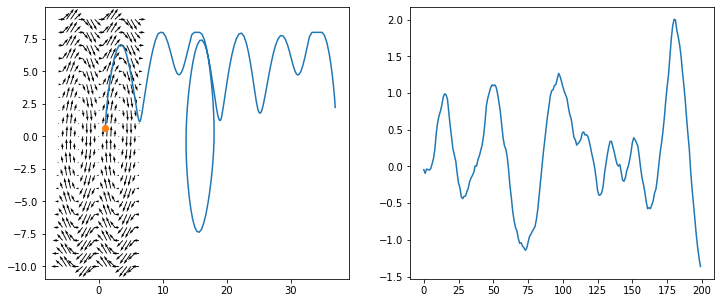

after 100 iters of optimization; total cost:921.9226056560874


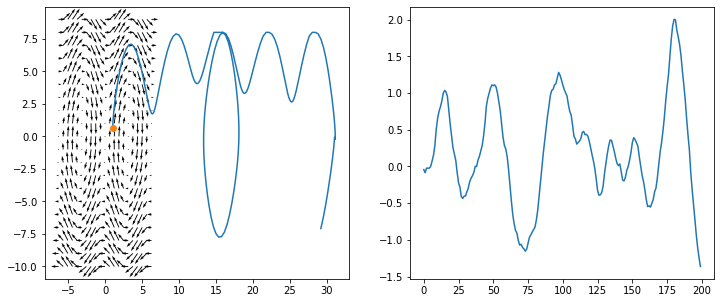

before optimization: total cost:1131.7030148506165


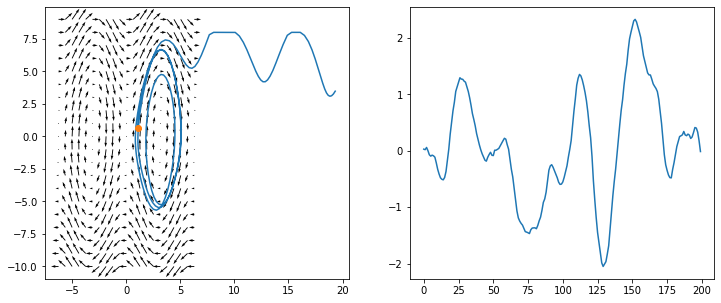

after 100 iters of optimization; total cost:1033.0542561113834


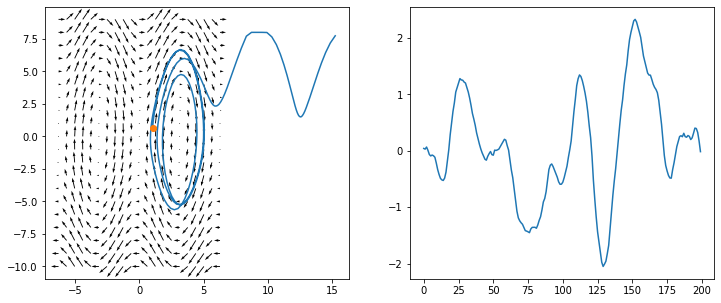

before optimization: total cost:1087.3094965070486


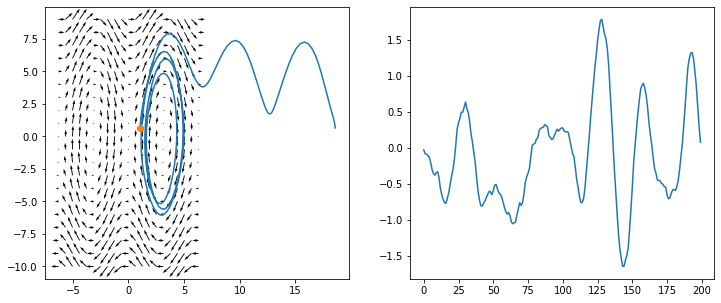

after 100 iters of optimization; total cost:1074.6596701666713


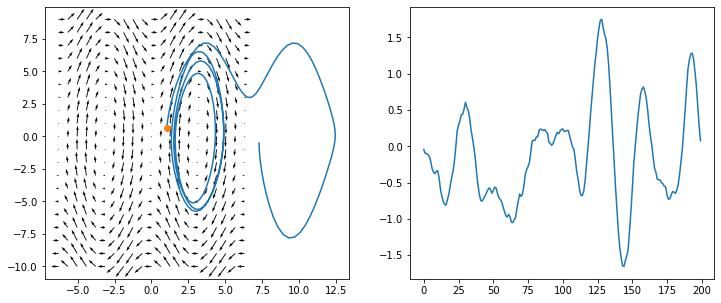

before optimization: total cost:994.1509145647287


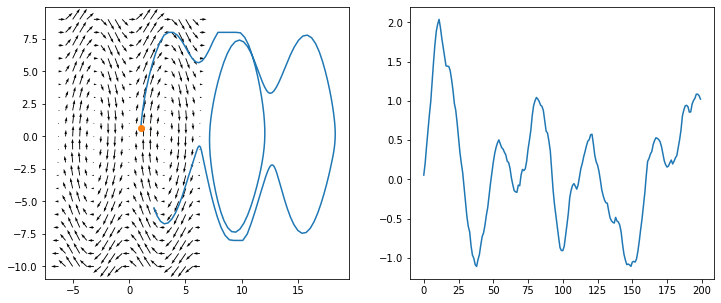

after 100 iters of optimization; total cost:903.306877778843


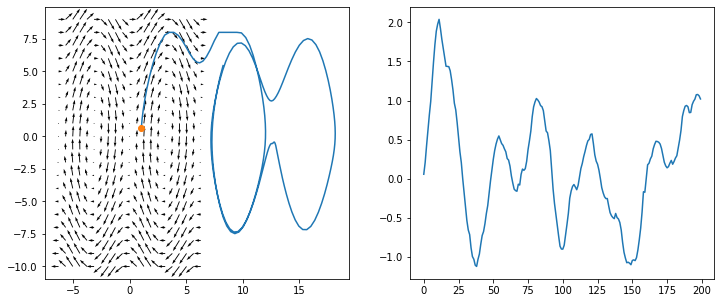

before optimization: total cost:899.6210247105919


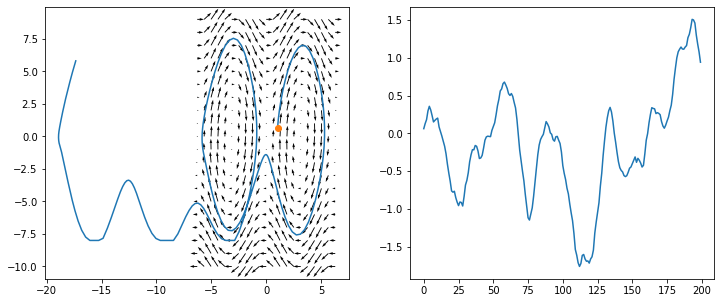

after 100 iters of optimization; total cost:980.2574549913406


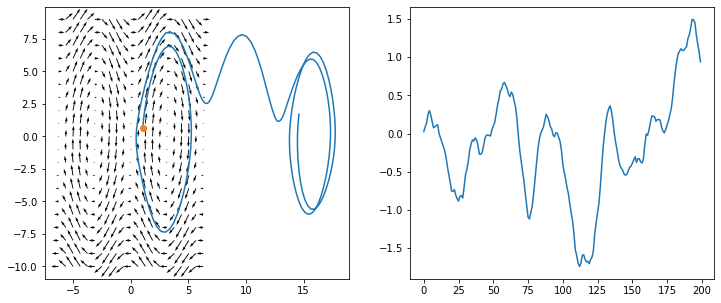

before optimization: total cost:1017.3642446100712


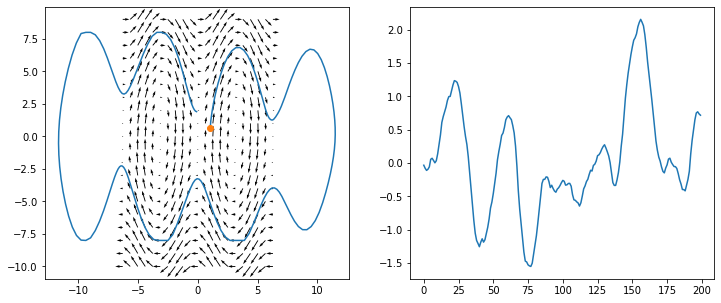

after 100 iters of optimization; total cost:994.0982786118984


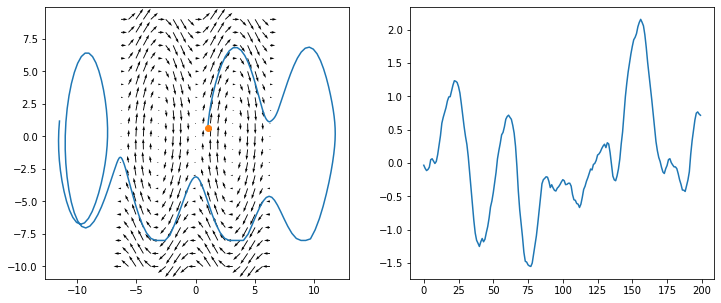

before optimization: total cost:1212.7487921714783


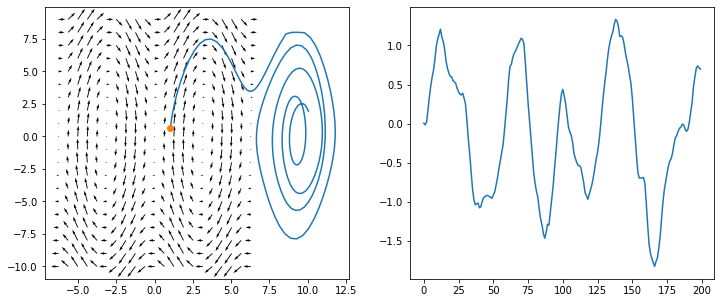

after 100 iters of optimization; total cost:1015.7468265034258


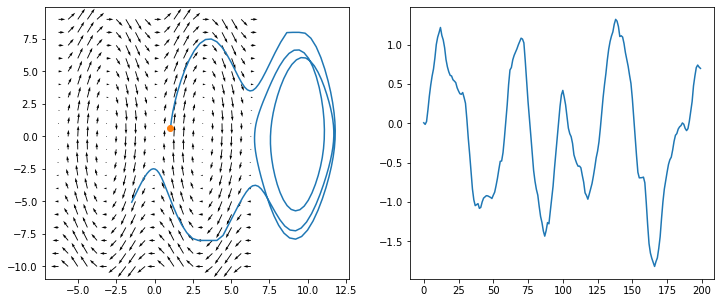

before optimization: total cost:1104.4817004799843


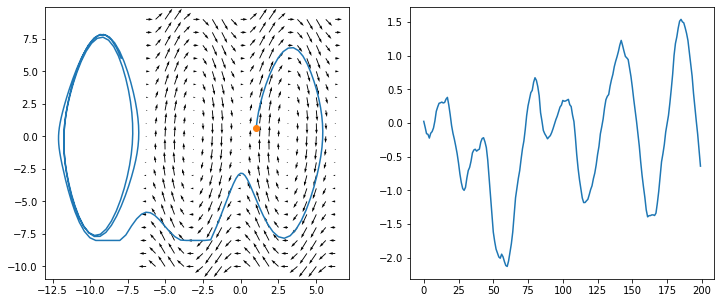

after 100 iters of optimization; total cost:991.4714350940194


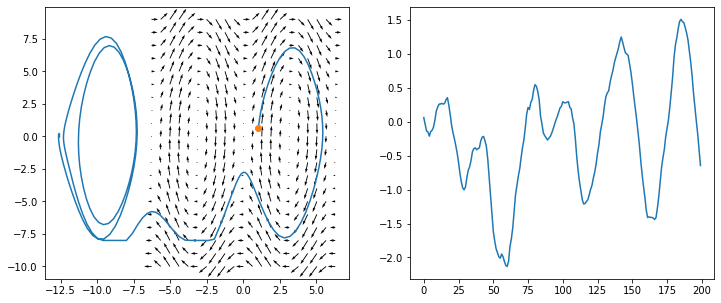

before optimization: total cost:1186.854685306549


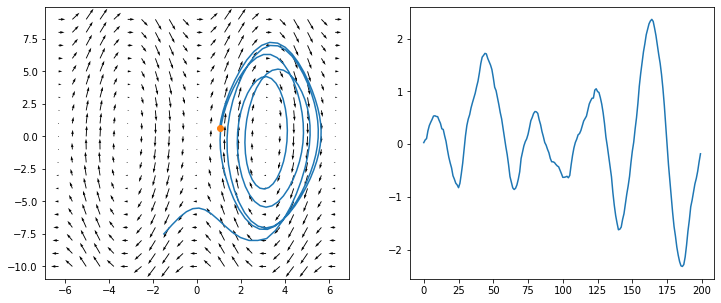

after 100 iters of optimization; total cost:1150.1939056664705


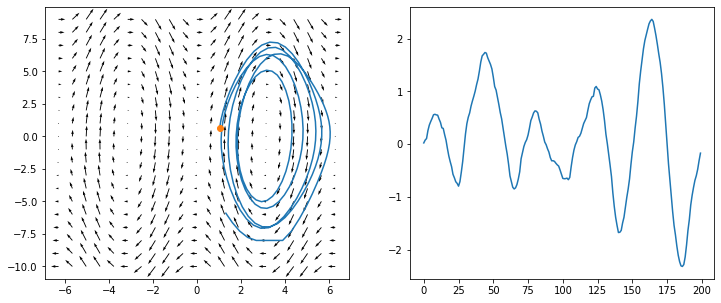

before optimization: total cost:1206.6189643144608


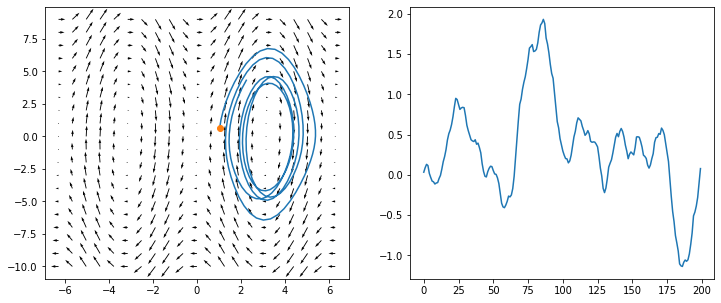

after 100 iters of optimization; total cost:1158.9291314184666


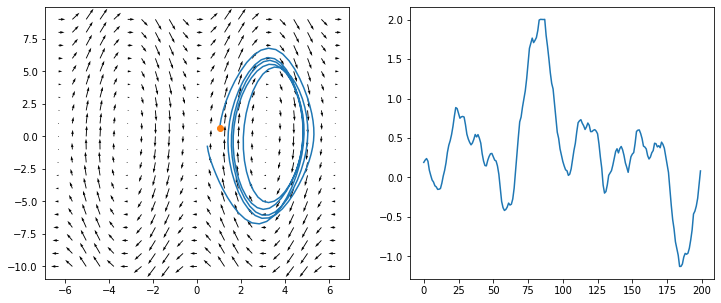

before optimization: total cost:1014.8972991406918


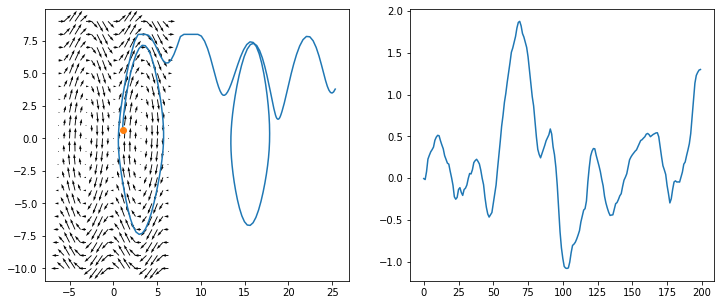

after 100 iters of optimization; total cost:1006.399345472455


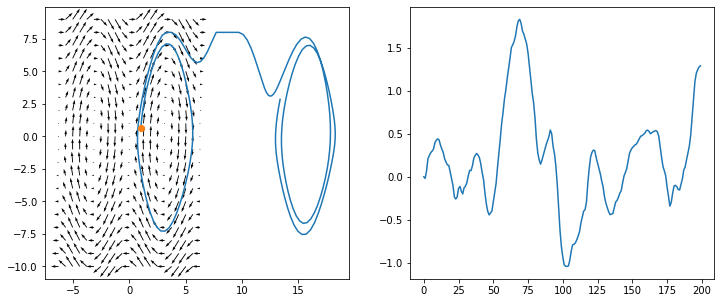

In [212]:
# optimize random initial control vector (OU noise)
# NOTE: OUNOISE seems to be worse than random normal

random_starts = 20
opt_iters = 100
LR = .1
th0, thdot0 = 1.0, 0.0

T = 100

for j in range(random_starts):
    key = random.PRNGKey(int(numpy.random.rand(1)*1000000))
    uVect = dampedSpringNoiseJit(200, sigma=.05, theta=.02, phi=.1, key=key)

    traj = pendulumTraj_scan(th0, thdot0, uVect, params)
    print(f"before optimization: total cost:{sum(traj[:,-1])}")
    plotTrajInPhaseSpace(traj, params, uVect)

    for i in range(opt_iters):
        dgdu = trajectoryGrad_scan(th0, thdot0, uVect, params)
        uVect = uVect - LR*(0.99**i) * dgdu/np.linalg.norm(dgdu)        

    traj = pendulumTraj_scan(th0, thdot0, uVect, params)
    print(f"after {opt_iters} iters of optimization; total cost:{sum(traj[:,-1])}")
    plotTrajInPhaseSpace(traj, params, uVect)

In [291]:
def get_best_random_control(best_so_far, th, thdot, params, random_starts, horizon): 
    best_traj_cost, best_traj, best_u = best_so_far
    for j in range(random_starts):
        # uVect = 2*numpy.random.randn(T-t)
        key = random.PRNGKey(int(numpy.random.rand(1)*1000000))
        uVect = np.clip(
            dampedSpringNoiseJit(horizon, sigma=.2, theta=.005, phi=.2, key=key),
            -params.max_torque,
            params.max_torque
        )
        traj = pendulumTraj_scan(th, thdot, uVect, params)
        traj_cost = costOfTrajectory(traj)
        if traj_cost < best_traj_cost:
            best_traj_cost = traj_cost
            best_traj = traj
            best_u = uVect
    return best_traj_cost, best_traj, best_u

def optimize_control(best_so_far, th, thdot, params, opt_iters, LR):
    best_traj_cost, best_traj, best_u = best_so_far
    uVect = best_u
    for i in range(opt_iters):
        dgdu = trajectoryGrad_scan(th, thdot, uVect, params)
        uVect = uVect - LR*(0.99**i) * dgdu/np.linalg.norm(dgdu)
        traj = pendulumTraj_scan(th, thdot, uVect, params)
        traj_cost = costOfTrajectory(traj)
        if traj_cost < best_traj_cost:
            best_traj_cost = traj_cost
            best_traj = traj
            best_u = uVect
    return best_traj_cost, best_traj, best_u

t: 0; best trajectory cost: 121.85718
t: 1; best trajectory cost: 296.08804
t: 2; best trajectory cost: 219.84468
t: 3; best trajectory cost: 218.10716
t: 4; best trajectory cost: 217.26419
t: 5; best trajectory cost: 217.03229
t: 6; best trajectory cost: 217.26651
t: 7; best trajectory cost: 207.58517
t: 8; best trajectory cost: 202.01549
t: 9; best trajectory cost: 197.49803
t: 10; best trajectory cost: 193.74272
t: 11; best trajectory cost: 191.15601
t: 12; best trajectory cost: 189.78749
t: 13; best trajectory cost: 189.47787
t: 14; best trajectory cost: 190.22026
t: 15; best trajectory cost: 192.15622
t: 16; best trajectory cost: 195.04776
t: 17; best trajectory cost: 196.70714
t: 18; best trajectory cost: 197.04387
t: 19; best trajectory cost: 196.02531
t: 20; best trajectory cost: 193.68071
t: 21; best trajectory cost: 181.07768
t: 22; best trajectory cost: 171.31055
t: 23; best trajectory cost: 163.93002
t: 24; best trajectory cost: 157.68375
t: 25; best trajectory cost: 152.57

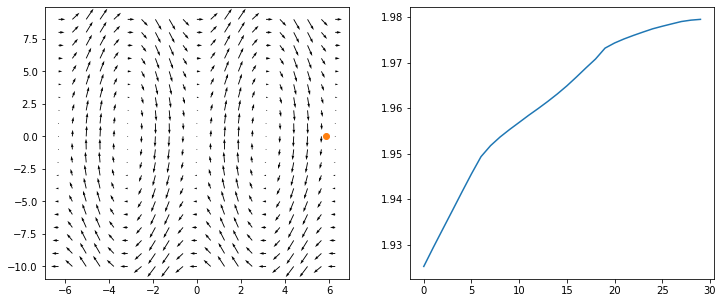

t: 100; best trajectory cost: 4.78774
t: 101; best trajectory cost: 4.66810
t: 102; best trajectory cost: 4.54128
t: 103; best trajectory cost: 4.41463
t: 104; best trajectory cost: 4.22685
t: 105; best trajectory cost: 4.30902
t: 106; best trajectory cost: 4.48274
t: 107; best trajectory cost: 4.79698
t: 108; best trajectory cost: 5.32864
t: 109; best trajectory cost: 6.19153
t: 110; best trajectory cost: 5.55540
t: 111; best trajectory cost: 5.55799
t: 112; best trajectory cost: 5.55887
t: 113; best trajectory cost: 5.55889
t: 114; best trajectory cost: 5.55766
t: 115; best trajectory cost: 5.55454
t: 116; best trajectory cost: 5.54985
t: 117; best trajectory cost: 5.54290
t: 118; best trajectory cost: 4.71055
t: 119; best trajectory cost: 4.58364
t: 120; best trajectory cost: 4.19216
t: 121; best trajectory cost: 4.20876
t: 122; best trajectory cost: 4.27640
t: 123; best trajectory cost: 4.42878
t: 124; best trajectory cost: 4.71105
t: 125; best trajectory cost: 5.19378
t: 126; best

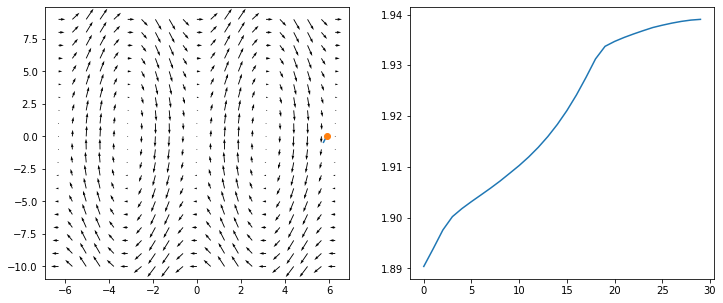

t: 200; best trajectory cost: 5.72075
t: 201; best trajectory cost: 6.85468
t: 202; best trajectory cost: 4.82420
t: 203; best trajectory cost: 4.73264
t: 204; best trajectory cost: 4.62891
t: 205; best trajectory cost: 4.51435
t: 206; best trajectory cost: 4.39135
t: 207; best trajectory cost: 4.26672
t: 208; best trajectory cost: 4.15089
t: 209; best trajectory cost: 4.06165
t: 210; best trajectory cost: 4.02271
t: 211; best trajectory cost: 4.06260
t: 212; best trajectory cost: 4.15263
t: 213; best trajectory cost: 4.33534
t: 214; best trajectory cost: 4.66187
t: 215; best trajectory cost: 5.20898
t: 216; best trajectory cost: 6.09293
t: 217; best trajectory cost: 5.35178
t: 218; best trajectory cost: 5.35702
t: 219; best trajectory cost: 5.36239
t: 220; best trajectory cost: 5.36764
t: 221; best trajectory cost: 5.37357
t: 222; best trajectory cost: 5.37958
t: 223; best trajectory cost: 5.38505
t: 224; best trajectory cost: 5.39085
t: 225; best trajectory cost: 5.39707
t: 226; best

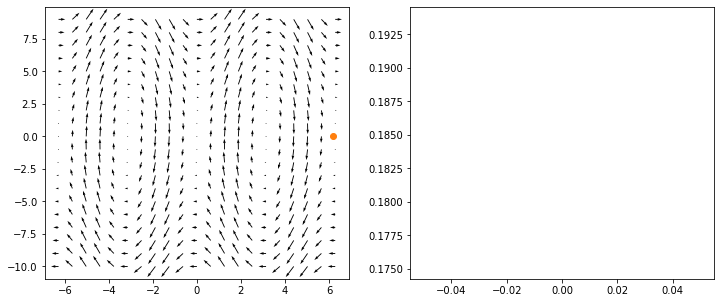

total time: 20.80s; 0.0693 s/timestep
final trajectory cost: 500.50018310546875


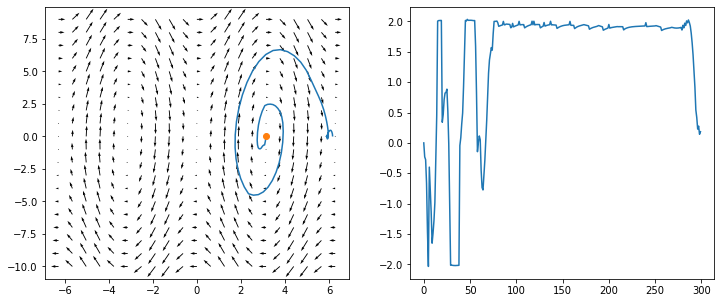

In [303]:
# optimizing ALL candidate trajectories, as above, is way too slow.
# maybe just optimize the *best* inputs

random_starts = 5
opt_iters = 5

LR = .1
th0, thdot0 = np.pi, 0.0

T = 300
H = 30

steps_per_epoch = 100

finalInputs = numpy.zeros(T)
best_traj_cost = np.inf

start_time = time.time()
for t in range(T):
    # always keep the best trajectory from the last iteration
    # available as an option (for iters after 0)
    if t == 0:
        best_u = numpy.zeros(H)
        best_traj = pendulumTraj_scan(th, thdot, best_u, params)
        best_traj_cost = costOfTrajectory(best_traj)
        th, thdot = th0, thdot0
    else:
        if H <= T-t:
            # best traj/inputs with last val carried forward
            best_u = np.hstack([best_u[1:],best_u[-1]])
        else:
            best_u = best_u[1:]
        best_traj = pendulumTraj_scan(th, thdot, best_u, params)
        best_traj_cost = costOfTrajectory(best_traj)    
        H = len(best_u)
        # print("len(best_u)",H)    


    best_so_far = (best_traj_cost, best_traj, best_u)

    best_so_far = get_best_random_control(
        best_so_far, th, thdot, params, random_starts, H
    )

    best_cost, best_traj, best_u =  optimize_control(
        best_so_far, th, thdot, params, opt_iters, LR
    )

    
    # th = best_traj[0,0]
    # thdot = best_traj[0,1]best_u
    finalInputs[t] = best_u[0].item()
    finalTraj = pendulumTraj_scan(th0, thdot0, finalInputs[:t+1], params)
    th = finalTraj[-1,0]
    thdot = finalTraj[-1,1]

    print(f"t: {t}; best trajectory cost: {best_traj_cost:.5f}")
    if (t+1)%steps_per_epoch ==0:
        # final_traj = pendulumTraj_scan(th, thdot, best_u, params)
        plotTrajInPhaseSpace(best_traj, params, best_u)
        # final_traj = pendulumTraj_scan(th0, thdot0, finalInputs, params)
        # plotTrajInPhaseSpace(final_traj, params, finalInputs)

total_time = time.time() - start_time
print(f"total time: {total_time:.2f}s; {total_time/T:.4f} s/timestep")
final_traj = pendulumTraj_scan(th0, thdot0, finalInputs, params)
print(f"final trajectory cost: {costOfTrajectory(final_traj)}")
plotTrajInPhaseSpace(final_traj, params, finalInputs)

final trajectory cost: 535.591796875


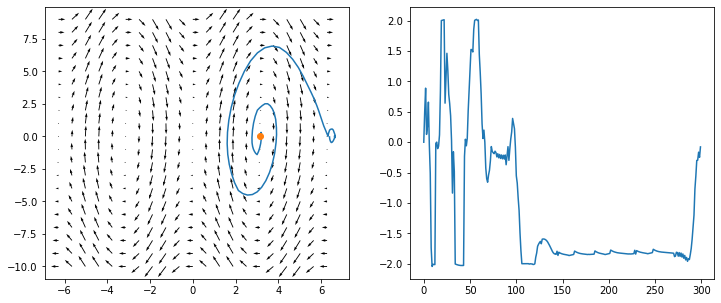

In [297]:

final_traj = pendulumTraj_scan(th0, thdot0, finalInputs, params)
print(f"final trajectory cost: {costOfTrajectory(final_traj)}")
plotTrajInPhaseSpace(final_traj, params, finalInputs)

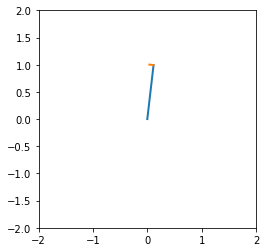

In [298]:
pendulum_traj_animation(final_traj, finalInputs, th)

t: 0; best trajectory cost: 296.08804
t: 1; best trajectory cost: 218.54524
t: 2; best trajectory cost: 217.72444
t: 3; best trajectory cost: 217.24495
t: 4; best trajectory cost: 217.09367
t: 5; best trajectory cost: 217.25896
t: 6; best trajectory cost: 204.97038
t: 7; best trajectory cost: 202.01735
t: 8; best trajectory cost: 199.97614
t: 9; best trajectory cost: 198.90266
t: 10; best trajectory cost: 198.80341
t: 11; best trajectory cost: 199.62166
t: 12; best trajectory cost: 201.23048
t: 13; best trajectory cost: 203.42859
t: 14; best trajectory cost: 204.69647
t: 15; best trajectory cost: 204.96349
t: 16; best trajectory cost: 204.20627
t: 17; best trajectory cost: 202.44727
t: 18; best trajectory cost: 188.73030
t: 19; best trajectory cost: 182.60660
t: 20; best trajectory cost: 178.36391
t: 21; best trajectory cost: 175.40428
t: 22; best trajectory cost: 173.79025
t: 23; best trajectory cost: 173.53868
t: 24; best trajectory cost: 174.60495
t: 25; best trajectory cost: 176.86

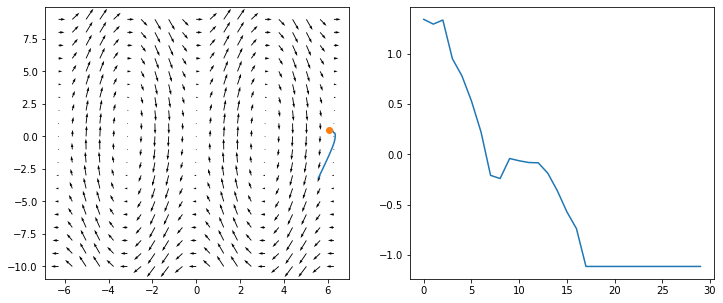

t: 100; best trajectory cost: 6.83528
t: 101; best trajectory cost: 10.12914
t: 102; best trajectory cost: 14.95684
t: 103; best trajectory cost: 21.84261
t: 104; best trajectory cost: 31.34175
t: 105; best trajectory cost: 43.82488
t: 106; best trajectory cost: 58.45619
t: 107; best trajectory cost: 73.89090
t: 108; best trajectory cost: 87.08566
t: 109; best trajectory cost: 21.72935
t: 110; best trajectory cost: 31.97195
t: 111; best trajectory cost: 44.34634
t: 112; best trajectory cost: 35.00645
t: 113; best trajectory cost: 44.32755
t: 114; best trajectory cost: 55.42006
t: 115; best trajectory cost: 68.24558
t: 116; best trajectory cost: 79.90505
t: 117; best trajectory cost: 89.68704
t: 118; best trajectory cost: 97.71919
t: 119; best trajectory cost: 75.13362
t: 120; best trajectory cost: 88.50278
t: 121; best trajectory cost: 45.21217
t: 122; best trajectory cost: 19.23170
t: 123; best trajectory cost: 26.98244
t: 124; best trajectory cost: 37.19573
t: 125; best trajectory co

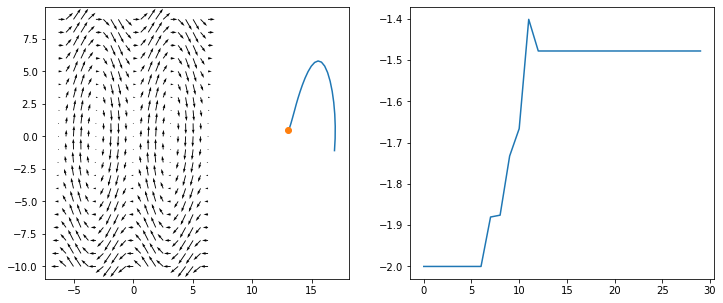

t: 200; best trajectory cost: 131.05524
t: 201; best trajectory cost: 136.39680
t: 202; best trajectory cost: 143.11000
t: 203; best trajectory cost: 133.40265
t: 204; best trajectory cost: 134.99677
t: 205; best trajectory cost: 122.95787
t: 206; best trajectory cost: 122.03751
t: 207; best trajectory cost: 120.68421
t: 208; best trajectory cost: 118.71032
t: 209; best trajectory cost: 115.87077
t: 210; best trajectory cost: 111.86990
t: 211; best trajectory cost: 106.37805
t: 212; best trajectory cost: 99.12295
t: 213; best trajectory cost: 89.95993
t: 214; best trajectory cost: 78.90903
t: 215; best trajectory cost: 66.33113
t: 216; best trajectory cost: 57.39744
t: 217; best trajectory cost: 52.70746
t: 218; best trajectory cost: 52.81953
t: 219; best trajectory cost: 57.46622
t: 220; best trajectory cost: 65.73625
t: 221; best trajectory cost: 77.62868
t: 222; best trajectory cost: 20.39968
t: 223; best trajectory cost: 23.97375
t: 224; best trajectory cost: 30.15265
t: 225; best 

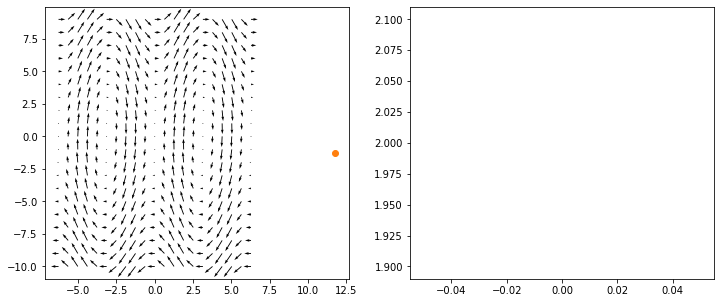

total time: 13.05s; 0.0435 s/timestep
final trajectory cost: 1051.254150390625


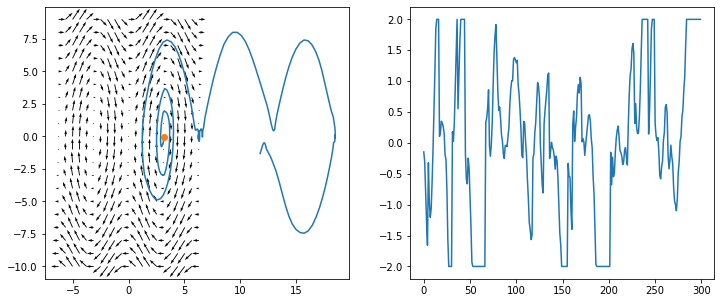

In [305]:
# with smoother noise, is the optimization step even needed?

random_starts = 5
opt_iters = 5

LR = .1
th0, thdot0 = np.pi, 0.0

T = 300
H = 30

steps_per_epoch = 100

finalInputs = numpy.zeros(T)
best_traj_cost = np.inf
start_time = time.time()
for t in range(T):
    # always keep the best trajectory from the last iteration
    # available as an option (for iters after 0)
    if t == 0:
        best_u = numpy.zeros(H)
        best_traj = pendulumTraj_scan(th, thdot, best_u, params)
        best_traj_cost = costOfTrajectory(best_traj)
        th, thdot = th0, thdot0
    else:
        if H <= T-t:
            # best traj/inputs with last val carried forward
            best_u = np.hstack([best_u[1:],best_u[-1]])
        else:
            best_u = best_u[1:]
        best_traj = pendulumTraj_scan(th, thdot, best_u, params)
        best_traj_cost = costOfTrajectory(best_traj)    
        H = len(best_u)


    best_so_far = (best_traj_cost, best_traj, best_u)

    best_cost, best_traj, best_u = get_best_random_control(
        best_so_far, th, thdot, params, random_starts, H
    )

    # best_cost, best_traj, best_u =  optimize_control(
    #     best_so_far, th, thdot, params, opt_iters, LR
    # )

    finalInputs[t] = best_u[0].item()
    finalTraj = pendulumTraj_scan(th0, thdot0, finalInputs[:t+1], params)
    th = finalTraj[-1,0]
    thdot = finalTraj[-1,1]

    print(f"t: {t}; best trajectory cost: {best_traj_cost:.5f}")
    if (t+1)%steps_per_epoch ==0:
        plotTrajInPhaseSpace(best_traj, params, best_u)

total_time = time.time() - start_time
print(f"total time: {total_time:.2f}s; {total_time/T:.4f} s/timestep")
final_traj = pendulumTraj_scan(th0, thdot0, finalInputs, params)
print(f"final trajectory cost: {costOfTrajectory(final_traj)}")
plotTrajInPhaseSpace(final_traj, params, finalInputs)

it turns out the optimization step is critical, even if just for a few iters